In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Import all necessary Libraries

In [6]:
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import RFE
import joblib
import warnings
warnings.filterwarnings('ignore')

Import the Dataset

In [7]:
data = pd.read_csv('/content/drive/MyDrive/energydata_complete.csv')

Scalling

In [8]:
from sklearn.preprocessing import MinMaxScaler


# scale all numerical features except 'date' and 'Appliances'
# Create a scaler object
scaler = MinMaxScaler()

# Select numerical columns to scale
numerical_cols = data.select_dtypes(include=np.number).columns
numerical_cols = [col for col in numerical_cols if col not in ['Appliances']] # Exclude target variable
# Fit the scaler on the training data and transform both train and test sets
data[numerical_cols] = scaler.fit_transform(data[numerical_cols])

# Now the numerical features in 'data' are scaled
print(data.head())

                  date  Appliances    lights       T1      RH_1        T2  \
0  2016-01-11 17:00:00          60  0.428571  0.32735  0.566187  0.225345   
1  2016-01-11 17:10:00          60  0.428571  0.32735  0.541326  0.225345   
2  2016-01-11 17:20:00          50  0.428571  0.32735  0.530502  0.225345   
3  2016-01-11 17:30:00          50  0.571429  0.32735  0.524080  0.225345   
4  2016-01-11 17:40:00          60  0.571429  0.32735  0.531419  0.225345   

       RH_2        T3      RH_3        T4  ...        T9      RH_9     T_out  \
0  0.684038  0.215188  0.746066  0.351351  ...  0.223032  0.677290  0.372990   
1  0.682140  0.215188  0.748871  0.351351  ...  0.226500  0.678532  0.369239   
2  0.679445  0.215188  0.755569  0.344745  ...  0.219563  0.676049  0.365488   
3  0.678414  0.215188  0.758685  0.341441  ...  0.219563  0.671909  0.361736   
4  0.676727  0.215188  0.758685  0.341441  ...  0.219563  0.671909  0.357985   

   Press_mm_hg    RH_out  Windspeed  Visibility  Tdewpoi

Format the date and time column

In [9]:
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')
print(data['date'].dtype)

datetime64[ns]


In [5]:
# Get information about the dataset, including data types and missing values
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         19735 non-null  datetime64[ns]
 1   Appliances   19735 non-null  int64         
 2   lights       19735 non-null  int64         
 3   T1           19735 non-null  float64       
 4   RH_1         19735 non-null  float64       
 5   T2           19735 non-null  float64       
 6   RH_2         19735 non-null  float64       
 7   T3           19735 non-null  float64       
 8   RH_3         19735 non-null  float64       
 9   T4           19735 non-null  float64       
 10  RH_4         19735 non-null  float64       
 11  T5           19735 non-null  float64       
 12  RH_5         19735 non-null  float64       
 13  T6           19735 non-null  float64       
 14  RH_6         19735 non-null  float64       
 15  T7           19735 non-null  float64       
 16  RH_7

In [6]:
# Display the first few rows of the dataset
print(data.head())

                 date  Appliances  lights     T1       RH_1    T2       RH_2  \
0 2016-01-11 17:00:00          60      30  19.89  47.596667  19.2  44.790000   
1 2016-01-11 17:10:00          60      30  19.89  46.693333  19.2  44.722500   
2 2016-01-11 17:20:00          50      30  19.89  46.300000  19.2  44.626667   
3 2016-01-11 17:30:00          50      40  19.89  46.066667  19.2  44.590000   
4 2016-01-11 17:40:00          60      40  19.89  46.333333  19.2  44.530000   

      T3       RH_3         T4  ...         T9   RH_9     T_out  Press_mm_hg  \
0  19.79  44.730000  19.000000  ...  17.033333  45.53  6.600000        733.5   
1  19.79  44.790000  19.000000  ...  17.066667  45.56  6.483333        733.6   
2  19.79  44.933333  18.926667  ...  17.000000  45.50  6.366667        733.7   
3  19.79  45.000000  18.890000  ...  17.000000  45.40  6.250000        733.8   
4  19.79  45.000000  18.890000  ...  17.000000  45.40  6.133333        733.9   

   RH_out  Windspeed  Visibility  Tdew

In [7]:
# descriptive statistics for numerical features
print(data.describe())

                      date    Appliances        lights            T1  \
count                19735  19735.000000  19735.000000  19735.000000   
mean   2016-03-20 05:30:00     97.694958      3.801875     21.686571   
min    2016-01-11 17:00:00     10.000000      0.000000     16.790000   
25%    2016-02-14 23:15:00     50.000000      0.000000     20.760000   
50%    2016-03-20 05:30:00     60.000000      0.000000     21.600000   
75%    2016-04-23 11:45:00    100.000000      0.000000     22.600000   
max    2016-05-27 18:00:00   1080.000000     70.000000     26.260000   
std                    NaN    102.524891      7.935988      1.606066   

               RH_1            T2          RH_2            T3          RH_3  \
count  19735.000000  19735.000000  19735.000000  19735.000000  19735.000000   
mean      40.259739     20.341219     40.420420     22.267611     39.242500   
min       27.023333     16.100000     20.463333     17.200000     28.766667   
25%       37.333333     18.790000  

In [8]:
# Check for missing values in each column
print(data.isnull().sum())

date           0
Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64


Histogram

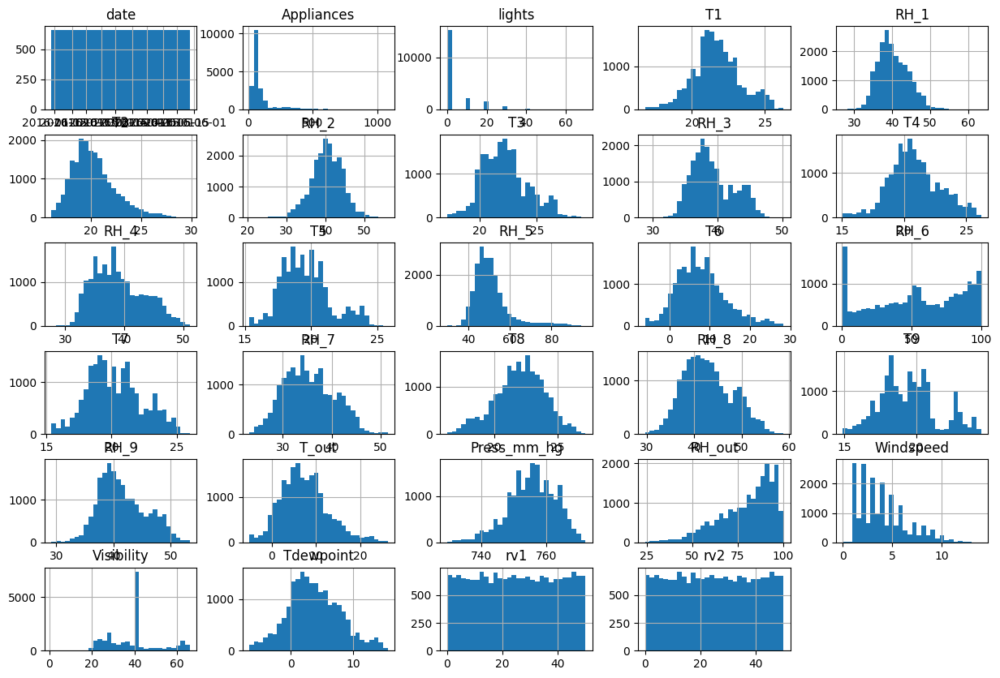

In [9]:
# Explore the distribution of numerical features using histograms
data.hist(bins=30, figsize=(15, 10))
plt.show()

Correlation HeatMap

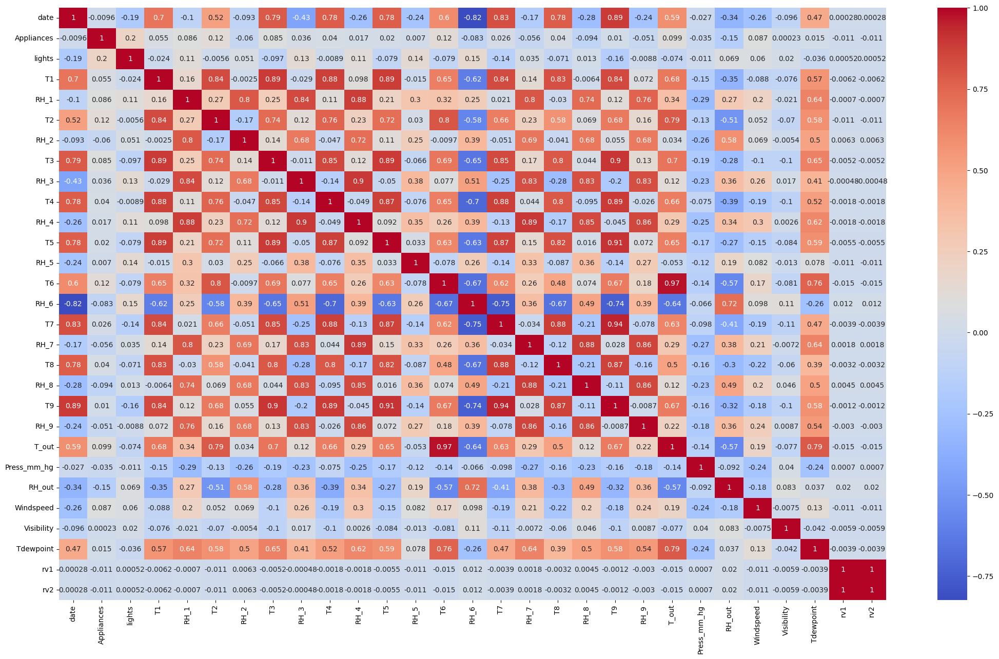

In [10]:
# Analyze the correlation between features using a heatmap
correlation_matrix = data.corr()
plt.figure(figsize=(26, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

PIE Chart

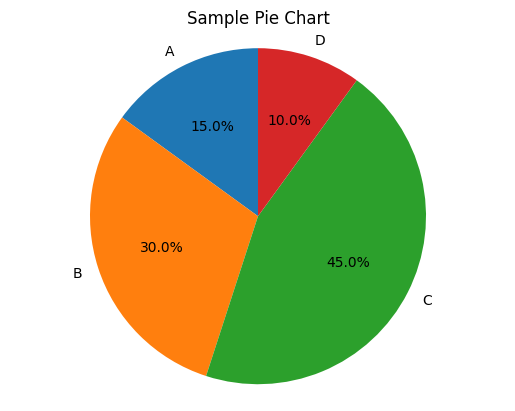

In [ ]:
# Create the pie chart
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Add a title
plt.title('Sample Pie Chart')

# Display the chart
plt.show()

Scatter Plot

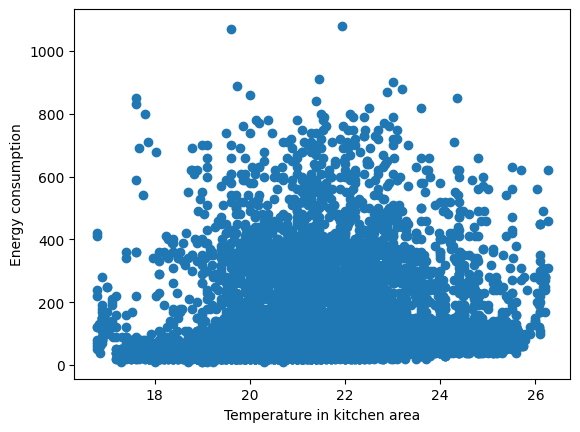

In [ ]:
# Explore the relationship between specific features using scatter plots
# Relationship between temperature and energy consumption
plt.scatter(data['T1'], data['Appliances'])
plt.xlabel('Temperature in kitchen area')
plt.ylabel('Energy consumption')
plt.show()

In [11]:
# Check for categorical features and analyze them
categorical_features = data.select_dtypes(include=['object']).columns

if len(categorical_features) > 0:
  for feature in categorical_features:
    print(f"Analyzing categorical feature: {feature}")
    sns.countplot(data[feature])
    plt.show()
else:
  print("No categorical features found in the dataset.")

No categorical features found in the dataset.


ValueError: num must be an integer with 1 <= num <= 12, not 13

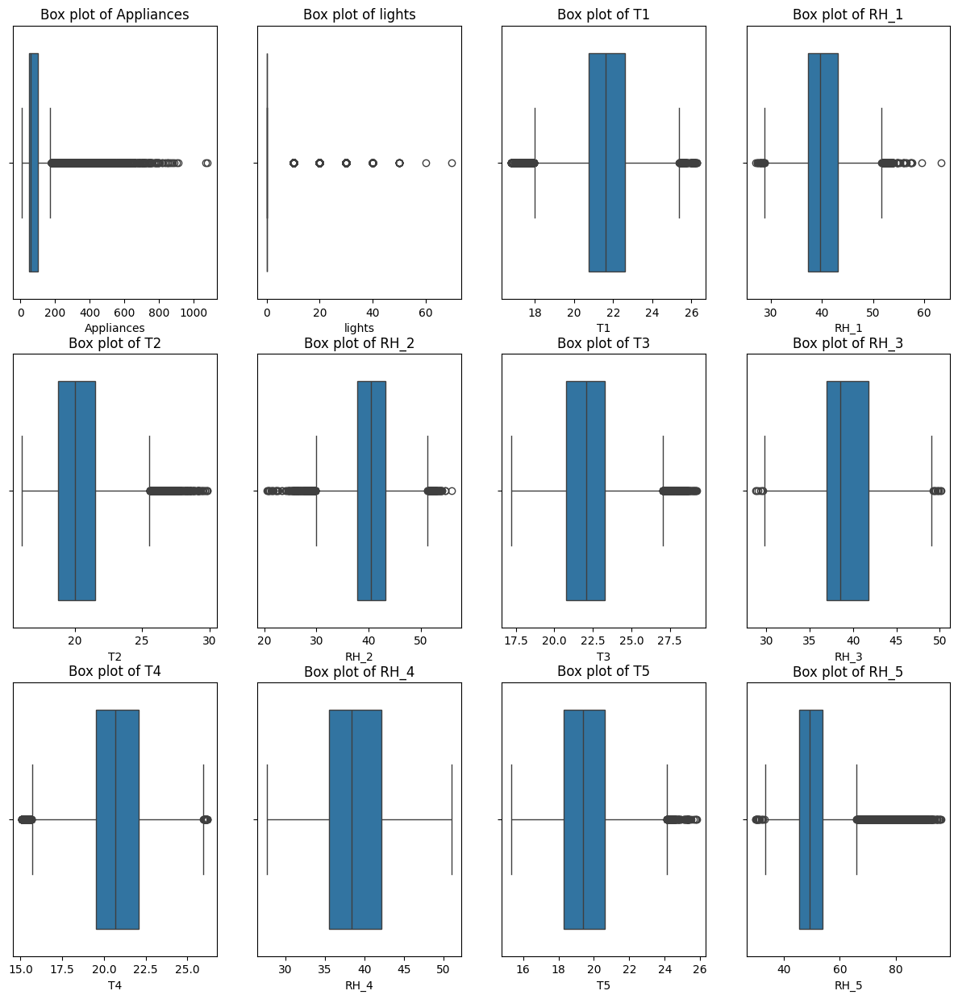

In [43]:
# Box plots to identify outliers
plt.figure(figsize=(15, 15))  # Adjust figure size as needed

for i, column in enumerate(data.select_dtypes(include=np.number).columns):
    plt.subplot(3, 4, i + 1)  # Adjust the grid size (rows, cols) as needed
    sns.boxplot(x=data[column])
    plt.title(f"Box plot of {column}")

plt.tight_layout()  # Adjust subplot parameters for a tight layout
plt.show()

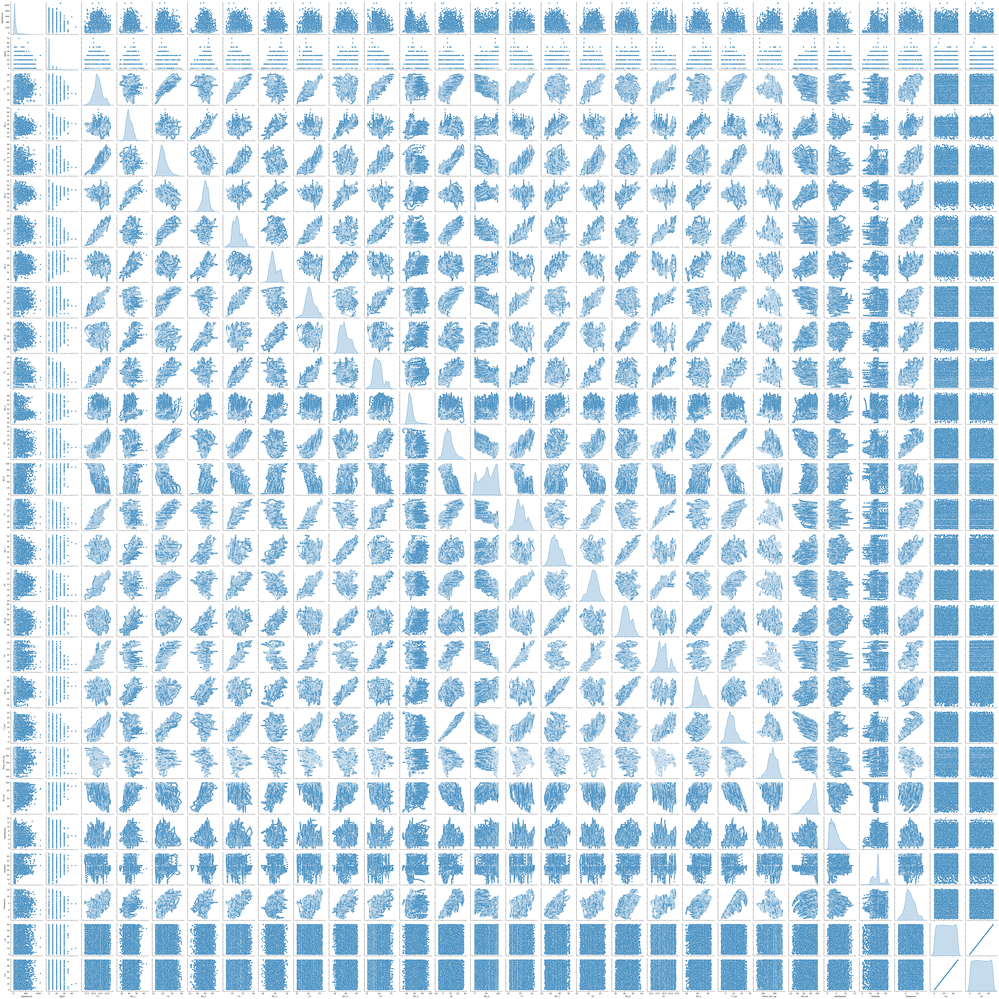

In [ ]:
# Pair plots to visualize relationships between multiple features
sns.pairplot(data, diag_kind='kde')
plt.show()

In [13]:
# Assuming 'date' or 'datetime' column exists
if 'date' in data.columns or 'datetime' in data.columns:
    if 'date' in data.columns:
        data['date'] = pd.to_datetime(data['date'])
    else:
        data['datetime'] = pd.to_datetime(data['datetime'])

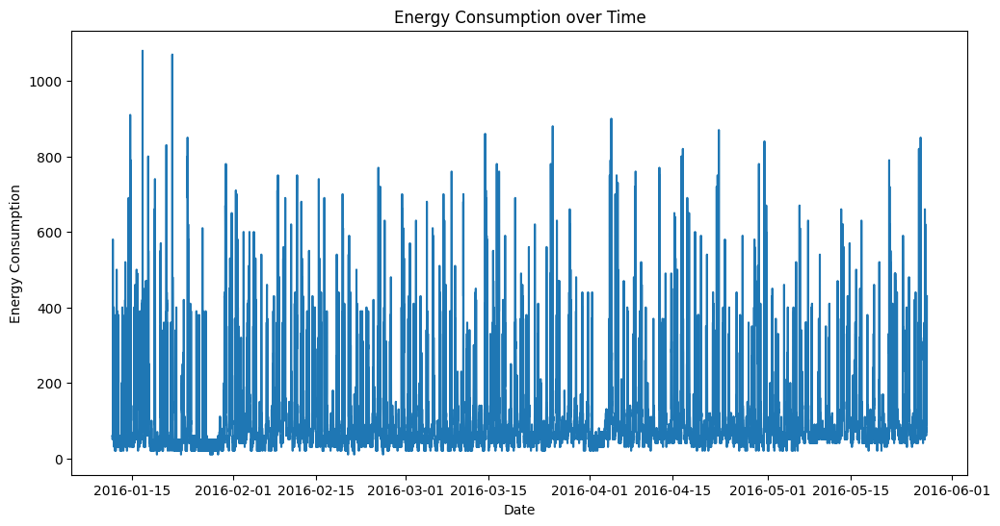

In [15]:
# plotting energy consumption over time
plt.figure(figsize=(12, 6))
plt.plot(data['date'], data['Appliances'])
plt.xlabel('Date')
plt.ylabel('Energy Consumption')
plt.title('Energy Consumption over Time')
plt.show()

In [10]:
# creating hour and day of the week features from datetime
if 'date' in data.columns:
    data['hour'] = data['date'].dt.hour
    data['day_of_week'] = data['date'].dt.dayofweek
elif 'datetime' in data.columns:
    data['hour'] = data['datetime'].dt.hour
    data['day_of_week'] = data['datetime'].dt.dayofweek

Head of the dataset

In [17]:
data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,hour,day_of_week
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433,17,0
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195,17,0
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668,17,0
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389,17,0
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097,17,0


Data Types

In [18]:
print(data.dtypes)

date           datetime64[ns]
Appliances              int64
lights                  int64
T1                    float64
RH_1                  float64
T2                    float64
RH_2                  float64
T3                    float64
RH_3                  float64
T4                    float64
RH_4                  float64
T5                    float64
RH_5                  float64
T6                    float64
RH_6                  float64
T7                    float64
RH_7                  float64
T8                    float64
RH_8                  float64
T9                    float64
RH_9                  float64
T_out                 float64
Press_mm_hg           float64
RH_out                float64
Windspeed             float64
Visibility            float64
Tdewpoint             float64
rv1                   float64
rv2                   float64
hour                    int32
day_of_week             int32
dtype: object


Convert date column

In [19]:
print(data['date'].dtype)

datetime64[ns]


Feature engineering functions

In [20]:
# Convert time to seconds since midnight
def second_day(x):
    return x.hour * 3600 + x.minute * 60 + x.second

# Classify day as weekend or weekday
def weekend_weekday(x):
    val = x.day_name()
    return "Weekend" if val in ["Saturday", "Sunday"] else "Weekday"

In [103]:
data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,mhr,NSM,WeekStatus,Day_of_week
0,2016-01-11 17:00:00,60,0.428571,0.32735,0.566187,0.225345,0.684038,0.215188,0.746066,0.351351,...,0.894737,0.500000,0.953846,0.538462,0.265449,0.265449,2016-01-11 17:00:00,61200,Weekday,Monday
1,2016-01-11 17:10:00,60,0.428571,0.32735,0.541326,0.225345,0.682140,0.215188,0.748871,0.351351,...,0.894737,0.476190,0.894872,0.533937,0.372083,0.372083,2016-01-11 17:00:00,61800,Weekday,Monday
2,2016-01-11 17:20:00,50,0.428571,0.32735,0.530502,0.225345,0.679445,0.215188,0.755569,0.344745,...,0.894737,0.452381,0.835897,0.529412,0.572848,0.572848,2016-01-11 17:00:00,62400,Weekday,Monday
3,2016-01-11 17:30:00,50,0.571429,0.32735,0.524080,0.225345,0.678414,0.215188,0.758685,0.341441,...,0.894737,0.428571,0.776923,0.524887,0.908261,0.908261,2016-01-11 17:00:00,63000,Weekday,Monday
4,2016-01-11 17:40:00,60,0.571429,0.32735,0.531419,0.225345,0.676727,0.215188,0.758685,0.341441,...,0.894737,0.404762,0.717949,0.520362,0.201611,0.201611,2016-01-11 17:00:00,63600,Weekday,Monday


Create new features and Apply feature engineering

In [11]:
data['NSM'] = data['date'].apply(second_day)
data['WeekStatus'] = data['date'].apply(weekend_weekday)
data['Day_of_week'] = data['date'].dt.day_name()


NameError: name 'second_day' is not defined

In [78]:
data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,NSM,WeekStatus,Day_of_week
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433,61200,Weekday,Monday
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195,61800,Weekday,Monday
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668,62400,Weekday,Monday
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389,63000,Weekday,Monday
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097,63600,Weekday,Monday


Convert categorical variables to factors (dummy variables in Python)

In [12]:
data = pd.get_dummies(data, columns=['WeekStatus', 'Day_of_week'])

KeyError: "None of [Index(['WeekStatus', 'Day_of_week'], dtype='object')] are in the [columns]"

Data visualization

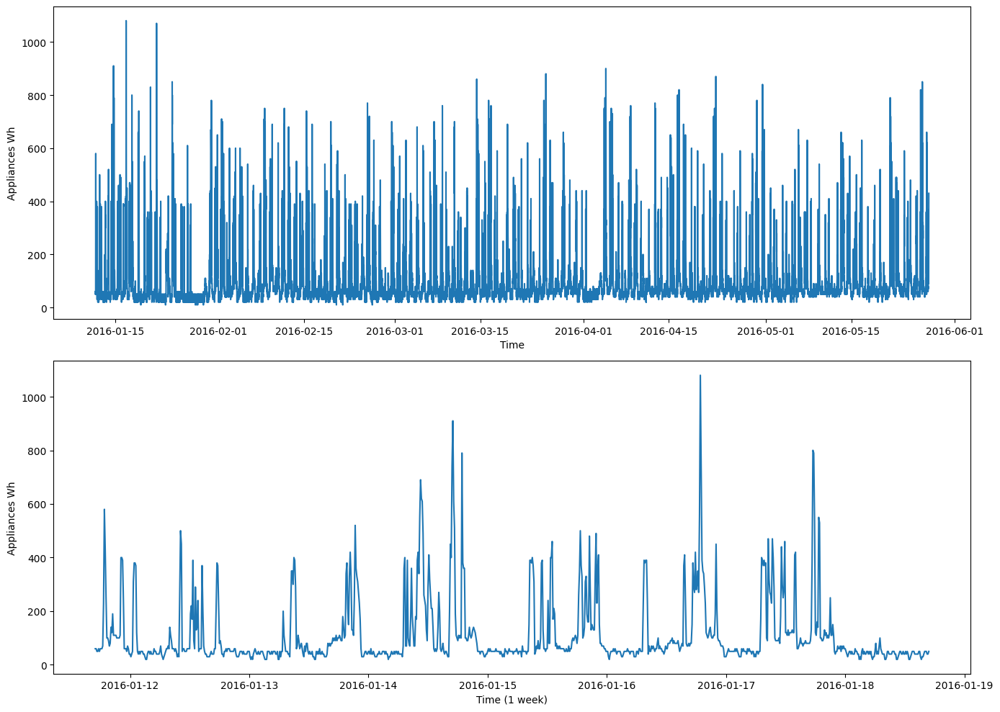

In [25]:
plt.figure(figsize=(14, 10))
plt.subplot(2, 1, 1)
plt.plot(data['date'], data['Appliances'])
plt.xlabel('Time')
plt.ylabel('Appliances Wh')

plt.subplot(2, 1, 2)
plt.plot(data['date'].iloc[:1008], data['Appliances'].iloc[:1008])
plt.xlabel('Time (1 week)')
plt.ylabel('Appliances Wh')
plt.tight_layout()


Histogram and boxplot

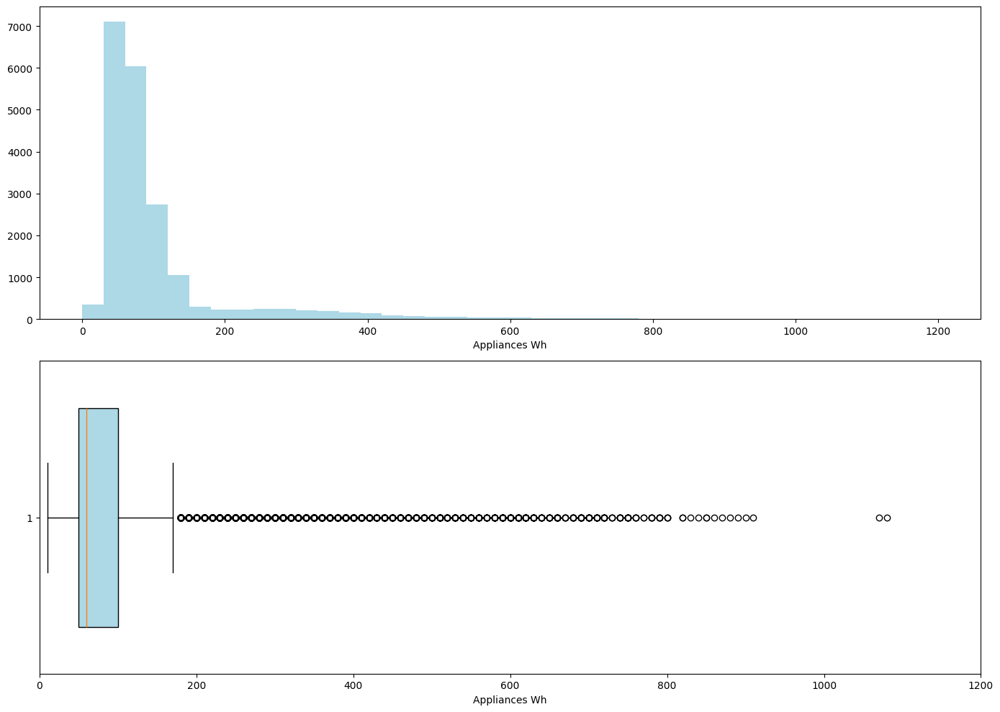

In [26]:
plt.figure(figsize=(14, 10))
plt.subplot(2, 1, 1)
plt.hist(data['Appliances'], bins=40, color='lightblue', range=(0, 1200))
plt.xlabel('Appliances Wh')

plt.subplot(2, 1, 2)
plt.boxplot(data['Appliances'], vert=False, patch_artist=True,
            boxprops=dict(facecolor='lightblue'), widths=0.7)
plt.xlim(0, 1200)
plt.xlabel('Appliances Wh')
plt.tight_layout()


Heatmap visualization

In [13]:
# Create hourly aggregates
data['mhr'] = data['date'].dt.floor('H')
hourly_data = data.groupby('mhr')['Appliances'].sum().reset_index()
hourly_data['Day_week'] = hourly_data['mhr'].dt.day_name()
hourly_data['week_year'] = hourly_data['mhr'].dt.isocalendar().week
hourly_data['Hour'] = hourly_data['mhr'].dt.hour

Create heatmaps for different weeks

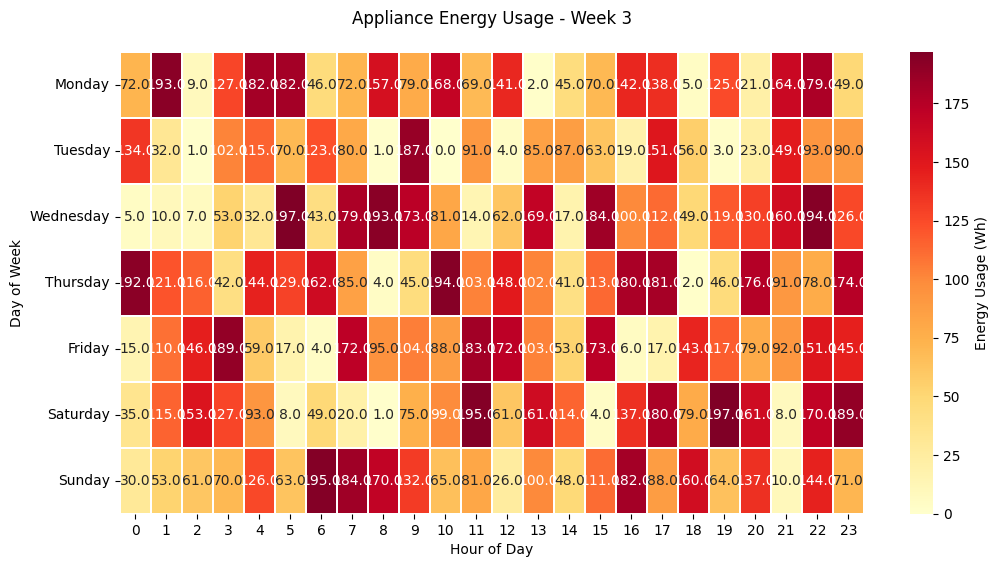

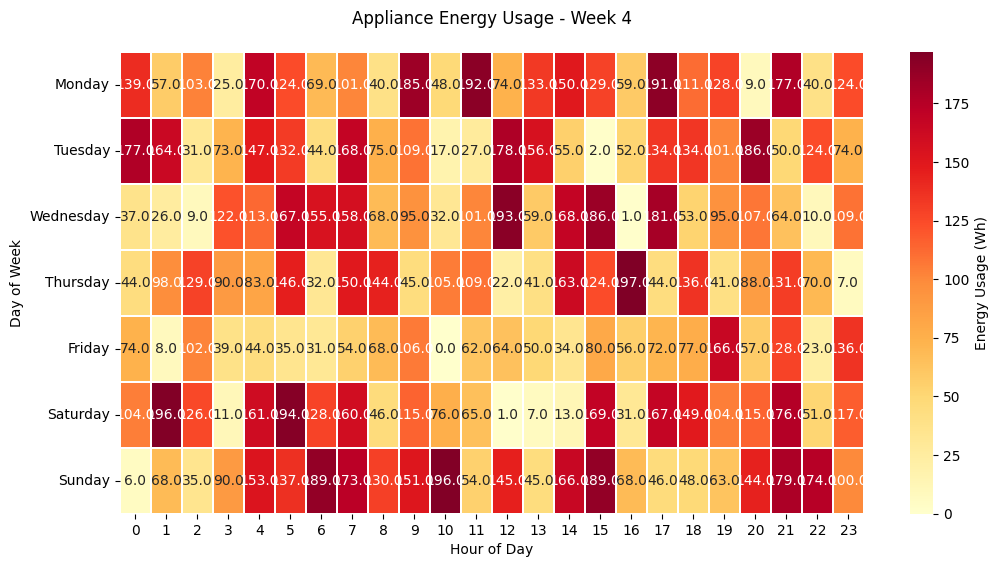

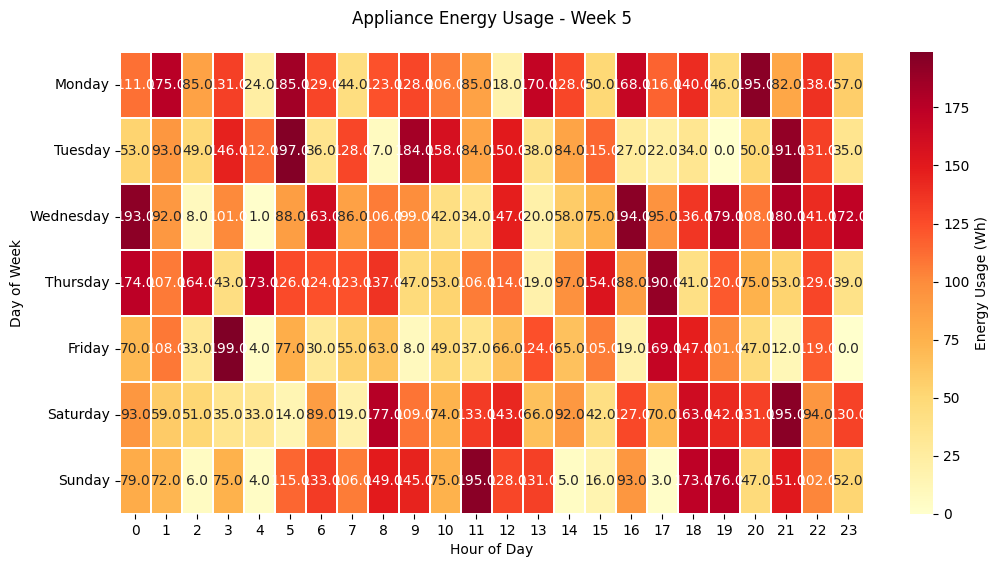

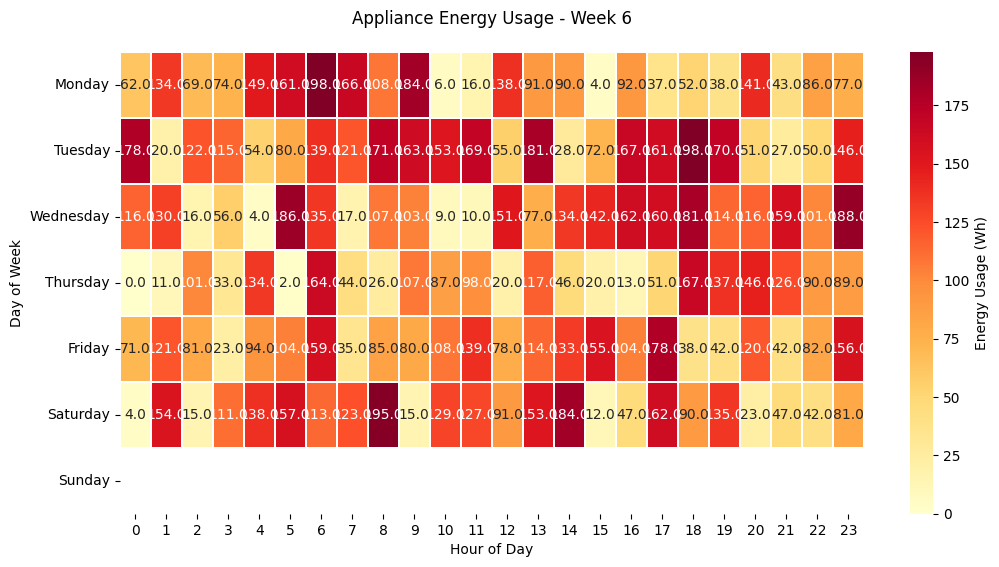

In [28]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def create_heatmap(data, week_num):
    week_data = data[data['week_year'] == week_num]
    # Pivot with correct parameters: index, columns, values
    pivot_data = week_data.pivot(index="Day_week", columns="Hour", values="Appliances")

    # Ensure days are sorted (Monday to Sunday)
    days_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
    pivot_data = pivot_data.reindex(days_order)

    plt.figure(figsize=(12, 6))
    sns.heatmap(pivot_data, cmap="YlOrRd", linewidths=0.3, annot=True, fmt=".1f",
                cbar_kws={'label': 'Energy Usage (Wh)'})
    plt.title(f'Appliance Energy Usage - Week {week_num}', pad=20)
    plt.xlabel('Hour of Day')
    plt.ylabel('Day of Week')
    plt.show()

# (replace with your actual data):
# DataFrame named 'data' with columns:
# 'week_year', 'Day_week', 'Hour', 'Appliances'
import numpy as np
import pandas as pd
from datetime import datetime, timedelta

# Create sample data
num_weeks = 6  # Number of weeks to generate data for
days_per_week = 7
hours_per_day = 24
total_records = num_weeks * days_per_week * hours_per_day

# Generate date range
start_date = datetime(2023, 1, 1)
date_range = [start_date + timedelta(hours=i) for i in range(total_records)]

# Generate random appliance usage data
appliance_usage = np.random.randint(0, 200, size=total_records)  # Adjust range as needed

# Create DataFrame
data = pd.DataFrame({
    'date': date_range,
    'Appliances': appliance_usage
})

# Extract week_year, Day_week, Hour
data['week_year'] = data['date'].dt.isocalendar().week
data['Day_week'] = data['date'].dt.day_name()
data['Hour'] = data['date'].dt.hour

# Create heatmaps for specific weeks
create_heatmap(data, 3)
create_heatmap(data, 4)
create_heatmap(data, 5)
create_heatmap(data, 6)

Correlation Analysis

                 date  Appliances    lights        T1      RH_1        T2  \
date         1.000000   -0.009630 -0.189835  0.696974 -0.102760  0.515321   
Appliances  -0.009630    1.000000  0.197278  0.055447  0.086031  0.120073   
lights      -0.189835    0.197278  1.000000 -0.023528  0.106968 -0.005622   
T1           0.696974    0.055447 -0.023528  1.000000  0.164006  0.836834   
RH_1        -0.102760    0.086031  0.106968  0.164006  1.000000  0.269839   
T2           0.515321    0.120073 -0.005622  0.836834  0.269839  1.000000   
RH_2        -0.092945   -0.060465  0.050985 -0.002509  0.797535 -0.165610   
T3           0.792938    0.085060 -0.097393  0.892402  0.253230  0.735245   
RH_3        -0.431939    0.036292  0.131161 -0.028550  0.844677  0.121497   
T4           0.781954    0.040281 -0.008859  0.877001  0.106180  0.762066   
RH_4        -0.263074    0.016965  0.114936  0.097861  0.880359  0.231563   
T5           0.777309    0.019760 -0.078745  0.885247  0.205797  0.720550   

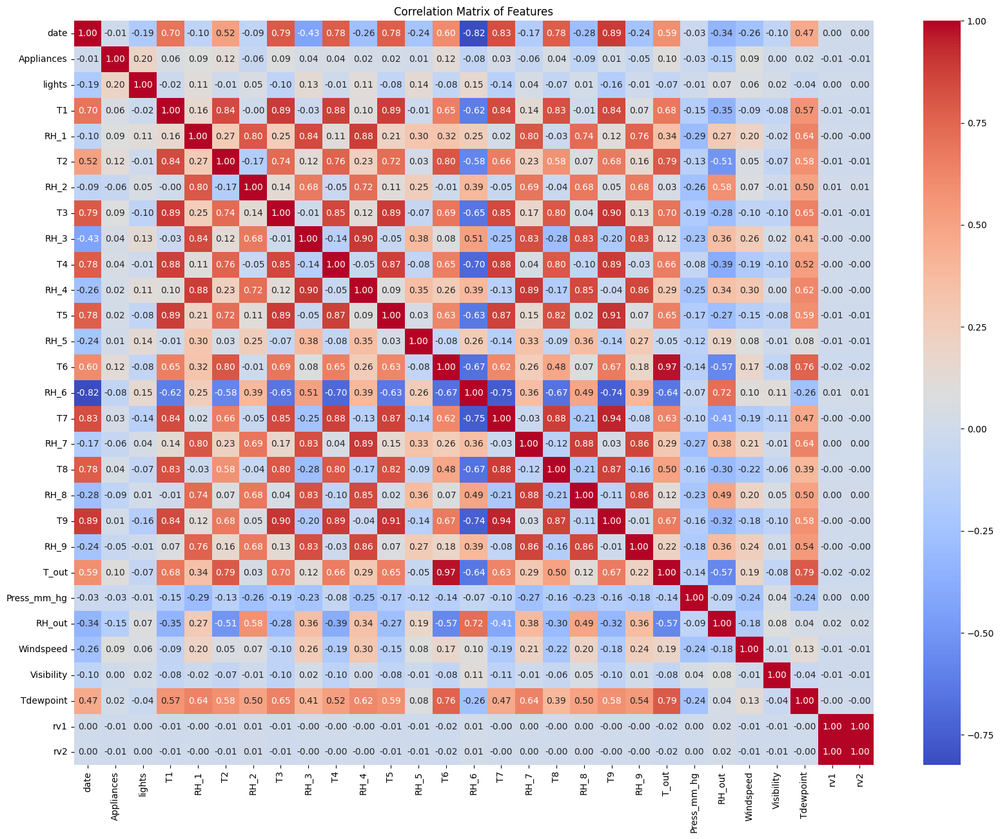

,Appliances
Appliances,1.000000
lights,0.197278
T2,0.120073
T6,0.117638
T_out,0.099155
Windspeed,0.087122
RH_1,0.086031
T3,0.085060
T1,0.055447
T4,0.040281


In [49]:
# Correlation Analysis
correlation_matrix = data.corr()
print(correlation_matrix)

# You can also visualize the correlation matrix using a heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Features')
plt.show()

# Find features highly correlated with 'Appliances' (energy consumption)
correlation_with_appliances = correlation_matrix['Appliances'].sort_values(ascending=False)
correlation_with_appliances

# You can select features with a correlation coefficient above a certain threshold
# (e.g., 0.5) to consider them as potentially important for prediction.


In [50]:
data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [51]:
# Select numeric columns for correlation
numeric_cols = train_data.select_dtypes(include=[np.number]).columns
corr_matrix = train_data[numeric_cols].corr()

<Axes: >

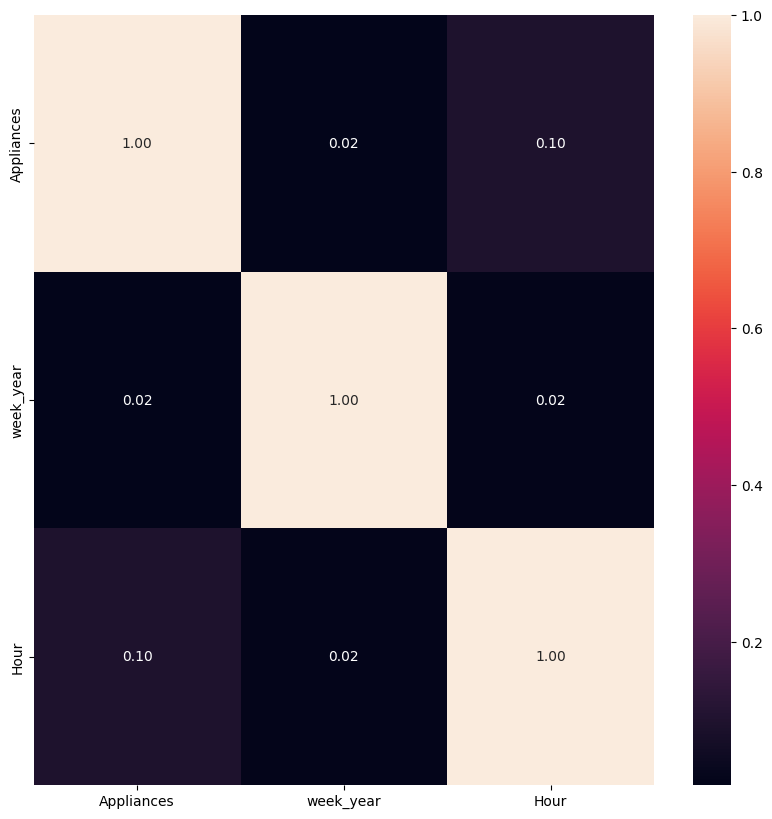

In [35]:
# Plot correlation matrices
plt.figure(figsize=(10, 10))
sns.heatmap(corr_matrix.iloc[:8, :8], annot=True, fmt=".2f")
#plt.savefig('firstpairsplot_train_set_Jan29.png', dpi=300)
#plt.close()

Data Splitting

In [14]:
# Remove unnecessary columns
#data.drop(['mhr', 'rv1', 'rv2','WeekStatus', 'Day_of_week'], axis=1, inplace=True, errors='ignore')
data.drop(['mhr','WeekStatus', 'Day_of_week'], axis=1, inplace=True, errors='ignore')

# Split into train and test
train_data, test_data = train_test_split(data, test_size=0.25, random_state=1)

# Save datasets
train_data.to_csv("training.csv", index=False)
test_data.to_csv("testing.csv", index=False)

In [105]:
train_data.columns

Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2', 'NSM'],
      dtype='object')

Model Training

In [53]:
'''
# Define evaluation metrics
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

def rsquared(y_true, y_pred):
    ss_res = np.sum((y_true - y_pred) ** 2)
    ss_tot = np.sum((y_true - np.mean(y_true)) ** 2)
    return 1 - (ss_res / ss_tot)
    '''

In [15]:
# Prepare data
X_train = train_data.drop(['date', 'Appliances'], axis=1)
y_train = train_data['Appliances']
X_test = test_data.drop(['date', 'Appliances'], axis=1)
y_test = test_data['Appliances']

In [16]:
X_train.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,hour,day_of_week
19278,0.000000,0.791975,0.375378,0.552459,0.526666,0.664673,0.489017,0.782883,0.573197,0.760631,...,0.598071,0.688372,0.605263,0.357143,0.430769,0.669683,0.141762,0.141762,14,1
14317,0.000000,0.475185,0.307586,0.166465,0.583091,0.431206,0.421717,0.576577,0.328468,0.446249,...,0.289925,0.883721,0.842105,0.214286,0.571795,0.395173,0.507777,0.507777,3,2
448,0.142857,0.627244,0.545913,0.413618,0.559471,0.404343,0.670977,0.341441,0.801252,0.169135,...,0.276527,0.451163,0.776316,0.547619,0.600000,0.342383,0.123639,0.123639,19,3
2835,0.571429,0.369588,0.445005,0.251999,0.604555,0.274177,0.707275,0.330030,0.674491,0.207358,...,0.329582,0.577907,0.901316,0.321429,0.507692,0.484163,0.556877,0.556877,9,6
5599,0.000000,0.391763,0.308412,0.213230,0.482613,0.404343,0.390092,0.327027,0.348556,0.187291,...,0.387460,0.726744,0.596491,0.297619,0.600000,0.376320,0.391041,0.391041,14,4


TimeSeries Analysis

ADF Statistic: -6.963529289444055
p-value: 9.036279104434882e-10
Critical Values:
   1%: -3.479742586699182
   5%: -2.88319822181578
   10%: -2.578319684499314


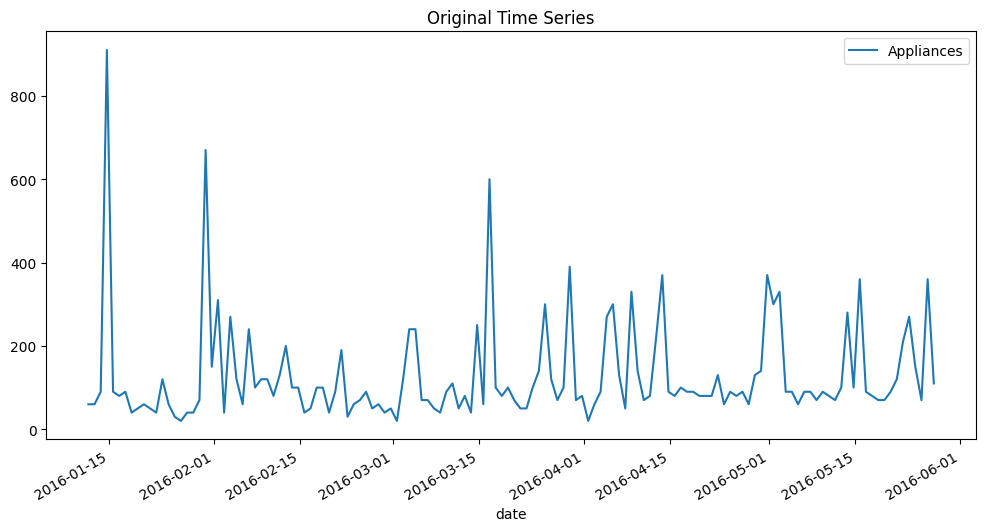

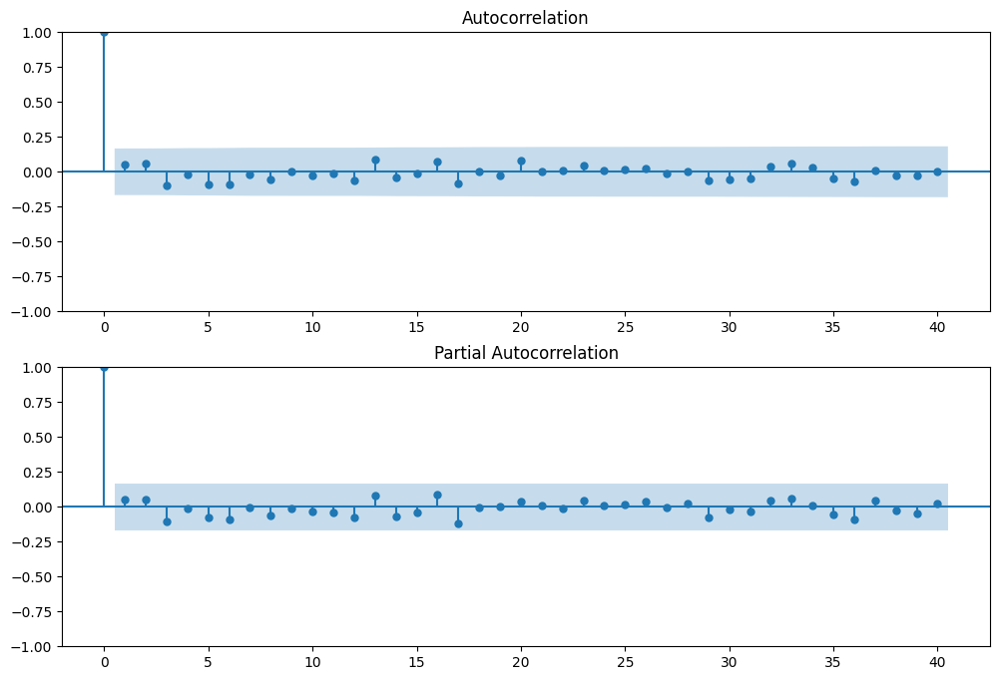

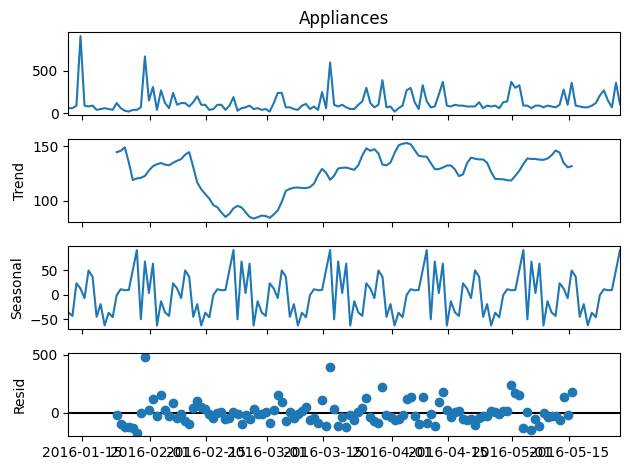


Using ARIMA order: (1, 1, 1)
RMSE: 109.24
MAE: 79.26
R-squared: -0.08
MAPE: 49.21%


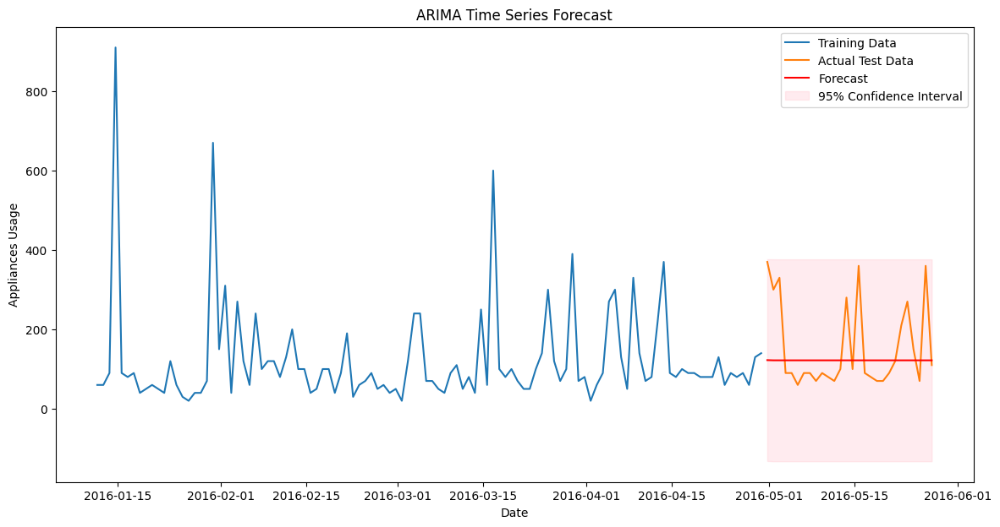

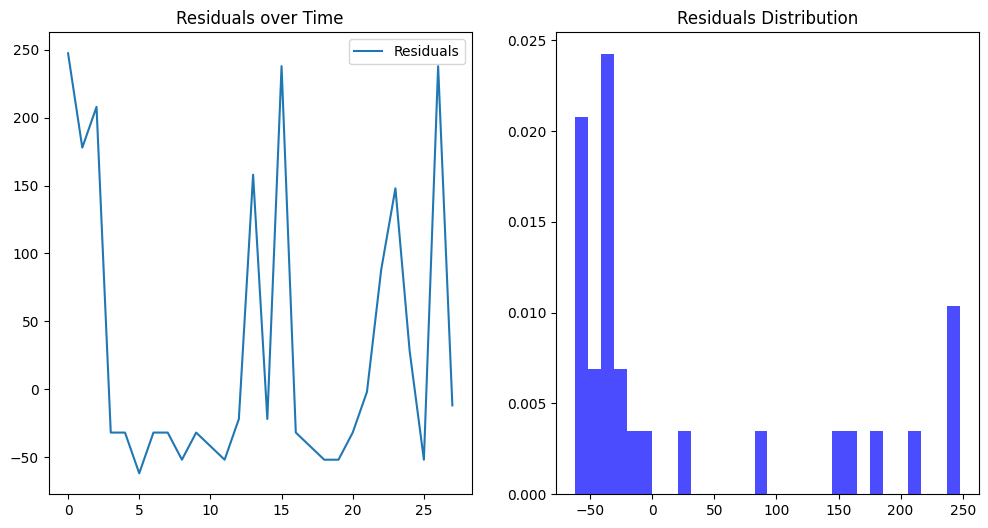

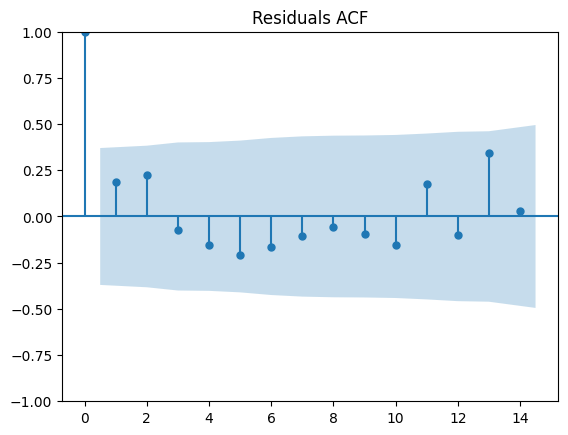

In [59]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.tsa.seasonal import seasonal_decompose

# Define the MAPE function
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 1. Data Preparation
ts_data = data[['date', 'Appliances']].copy()
ts_data['date'] = pd.to_datetime(ts_data['date'])
ts_data.set_index('date', inplace=True)
ts_data = ts_data.asfreq('D').fillna(method='ffill')

# 2. Stationarity Check
def check_stationarity(series):
    result = adfuller(series)
    print(f'ADF Statistic: {result[0]}')
    print(f'p-value: {result[1]}')
    print('Critical Values:')
    for key, value in result[4].items():
        print(f'   {key}: {value}')

check_stationarity(ts_data['Appliances'])

# 3. Visual Diagnostics
ts_data.plot(figsize=(12,6), title='Original Time Series')
plt.show()

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12,8))
plot_acf(ts_data['Appliances'], lags=40, ax=ax1)
plot_pacf(ts_data['Appliances'], lags=40, ax=ax2)
plt.show()

decomposition = seasonal_decompose(ts_data['Appliances'], model='additive', period=24)
decomposition.plot()
plt.show()

# 4. Model Training
train_size = int(len(ts_data) * 0.8)
train_ts, test_ts = ts_data[:train_size], ts_data[train_size:]

try:
    from pmdarima import auto_arima
    auto_model = auto_arima(train_ts, seasonal=False, trace=True)
    print(auto_model.summary())
    order = auto_model.order
except:
    order = (1, 1, 1)

print(f"\nUsing ARIMA order: {order}")

model = ARIMA(train_ts, order=order)
model_fit = model.fit()

# 5. Forecasting
forecast_steps = len(test_ts)
forecast = model_fit.get_forecast(steps=forecast_steps)
forecast_mean = forecast.predicted_mean
conf_int = forecast.conf_int()

# 6. Evaluation
def evaluate_forecast(actual, predicted):
    rmse = np.sqrt(mean_squared_error(actual, predicted))
    mae = mean_absolute_error(actual, predicted)
    r2 = r2_score(actual, predicted)
    mape_score = mape(actual, predicted)

    print(f"RMSE: {rmse:.2f}")
    print(f"MAE: {mae:.2f}")
    print(f"R-squared: {r2:.2f}")
    print(f"MAPE: {mape_score:.2f}%")

    return rmse, mae, r2, mape_score

evaluate_forecast(test_ts['Appliances'], forecast_mean)

# 7. Visualization
plt.figure(figsize=(14,7))
plt.plot(train_ts.index, train_ts['Appliances'], label='Training Data')
plt.plot(test_ts.index, test_ts['Appliances'], label='Actual Test Data')
plt.plot(test_ts.index, forecast_mean, label='Forecast', color='red')
plt.fill_between(test_ts.index,
                conf_int.iloc[:, 0],
                conf_int.iloc[:, 1],
                color='pink', alpha=0.3, label='95% Confidence Interval')
plt.title('ARIMA Time Series Forecast')
plt.xlabel('Date')
plt.ylabel('Appliances Usage')
plt.legend()
plt.show()

# 8. Residual Analysis
residuals = test_ts['Appliances'] - forecast_mean
residuals = residuals.dropna()
residuals = residuals[np.isfinite(residuals)]
residuals = residuals.values.flatten().astype(float)

if len(residuals) > 1:
    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.plot(residuals, label='Residuals')
    plt.title('Residuals over Time')
    plt.legend()

    plt.subplot(1,2,2)
    plt.hist(residuals, bins=30, density=True, alpha=0.7, color='blue')
    plt.title('Residuals Distribution')
    plt.show()

    lags = min(40, len(residuals) // 2)
    plot_acf(residuals, lags=lags)
    plt.title('Residuals ACF')
    plt.show()
else:
    print("Not enough residuals to plot ACF.")

Scalling the data

In [60]:
from sklearn.preprocessing import MinMaxScaler


# scale all numerical features except 'date' and 'Appliances'
# Create a scaler object
scaler = MinMaxScaler()

# Select numerical columns to scale
numerical_cols = data.select_dtypes(include=np.number).columns
numerical_cols = [col for col in numerical_cols if col not in ['Appliances']] # Exclude target variable
# Fit the scaler on the training data and transform both train and test sets
data[numerical_cols] = scaler.fit_transform(data[numerical_cols])

# Now the numerical features in 'data' are scaled
print(data.head())

                 date  Appliances    lights       T1      RH_1        T2  \
0 2016-01-11 17:00:00          60  0.428571  0.32735  0.566187  0.225345   
1 2016-01-11 17:10:00          60  0.428571  0.32735  0.541326  0.225345   
2 2016-01-11 17:20:00          50  0.428571  0.32735  0.530502  0.225345   
3 2016-01-11 17:30:00          50  0.571429  0.32735  0.524080  0.225345   
4 2016-01-11 17:40:00          60  0.571429  0.32735  0.531419  0.225345   

       RH_2        T3      RH_3        T4  ...        T8      RH_8        T9  \
0  0.684038  0.215188  0.746066  0.351351  ...  0.173329  0.661412  0.223032   
1  0.682140  0.215188  0.748871  0.351351  ...  0.173329  0.660155  0.226500   
2  0.679445  0.215188  0.755569  0.344745  ...  0.173329  0.655586  0.219563   
3  0.678414  0.215188  0.758685  0.341441  ...  0.164175  0.650788  0.219563   
4  0.676727  0.215188  0.758685  0.341441  ...  0.164175  0.650788  0.219563   

       RH_9     T_out  Press_mm_hg    RH_out  Windspeed  Visib

In [84]:
X_train.head()

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,NSM,WeekStatus,Day_of_week
19278,0,24.29,40.663333,23.700000,39.193333,25.200000,39.230000,23.790000,41.090000,23.29,...,38.950000,13.600000,758.90,70.000000,5.000000,29.000000,8.200000,50400,Weekday,Tuesday
14317,0,21.29,38.200000,18.390000,41.200000,22.390000,37.790000,21.500000,35.356000,20.00,...,40.863333,4.016667,767.30,88.000000,3.000000,38.166667,2.133333,11400,Weekday,Wednesday
448,10,22.73,46.860000,21.790000,40.360000,22.066667,43.123333,18.890000,46.433333,17.10,...,41.663333,3.600000,748.70,83.000000,7.666667,40.000000,0.966667,70800,Weekday,Thursday
2835,40,20.29,43.193333,19.566667,41.963333,20.500000,43.900000,18.763333,43.463333,17.50,...,48.133333,5.250000,754.15,92.500000,4.500000,34.000000,4.100000,34200,Weekend,Sunday
5599,0,20.50,38.230000,19.033333,37.626667,22.066667,37.113333,18.730000,35.826667,17.29,...,41.428571,7.050000,760.55,69.333333,4.166667,40.000000,1.716667,51000,Weekday,Friday


In [17]:
# Linear Regression
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

Multi Linear Regression

In [18]:
# Predict on the test set
y_pred_lr = lr.predict(X_test)

# Predict on the training set
y_pred_lr_train = lr.predict(X_train)  # Add this line

# Evaluate the model on the test set
rmse_lr = np.sqrt(mean_squared_error(y_test, y_pred_lr))
mae_lr = mean_absolute_error(y_test, y_pred_lr)
r2_lr = r2_score(y_test, y_pred_lr)
mape_lr = np.mean(np.abs((y_test - y_pred_lr) / y_test)) * 100

# Evaluate the model on the training set  (Add this block)
rmse_lr_train = np.sqrt(mean_squared_error(y_train, y_pred_lr_train))
mae_lr_train = mean_absolute_error(y_train, y_pred_lr_train)
r2_lr_train = r2_score(y_train, y_pred_lr_train)
mape_lr_train = np.mean(np.abs((y_train - y_pred_lr_train) / y_train)) * 100


print("Linear Regression Model Evaluation (Test Set):")
print(f"RMSE: {rmse_lr:.2f}")
print(f"MAE: {mae_lr:.2f}")
print(f"R-squared: {r2_lr:.2f}")
print(f"MAPE: {mape_lr:.2f}")

print("\nLinear Regression Model Evaluation (Training Set):")  # Add this block
print(f"RMSE: {rmse_lr_train:.2f}")
print(f"MAE: {mae_lr_train:.2f}")
print(f"R-squared: {r2_lr_train:.2f}")
print(f"MAPE: {mape_lr_train:.2f}")

# print the coefficients of the linear regression model:
print("Coefficients:", lr.coef_)
print("Intercept:", lr.intercept_)

Linear Regression Model Evaluation (Test Set):
RMSE: 95.21
MAE: 53.52
R-squared: 0.17
MAPE: 59.74

Linear Regression Model Evaluation (Training Set):
RMSE: 92.96
MAE: 52.08
R-squared: 0.17
MAPE: 60.11
Coefficients: [ 141.34878283  -28.16011618  506.38588139 -228.80618421 -445.09831653
  322.14380968  101.86150006  -34.43954072  -31.12316465    8.57142214
    4.92212351  257.20857366   32.51659167   23.21052523  -40.7333305
   66.36557811 -109.33198227 -138.96086219   -7.07660294 -338.57623213
    5.62713683  -78.88361018   26.08835445   10.18496795  105.48206756
   -0.52519901   -0.52519901    0.96281866    1.2102157 ]
Intercept: 164.63378358499466


Random Forest


Random Forest Model Evaluation (Training Set):
RMSE: 26.61
MAE: 12.47
R-squared: 0.93
MAPE: 12.39

Random Forest Model Evaluation (Testing Set):
RMSE: 71.71
MAE: 34.05
R-squared: 0.53
MAPE: 32.57

Feature Importance:
        Feature  Importance
27         hour    0.144590
5            T3    0.061753
6          RH_3    0.047051
20  Press_mm_hg    0.040886
15           T8    0.038415
10         RH_5    0.038336
4          RH_2    0.036613
2          RH_1    0.034753
0        lights    0.033359
24    Tdewpoint    0.033109
18         RH_9    0.032958
9            T5    0.031104
16         RH_8    0.031014
21       RH_out    0.029871
12         RH_6    0.029242
11           T6    0.028605
8          RH_4    0.028383
13           T7    0.027866
19        T_out    0.027800
17           T9    0.027673
14         RH_7    0.027166
22    Windspeed    0.026586
7            T4    0.026400
3            T2    0.024138
1            T1    0.023638
23   Visibility    0.021476
26          rv2    0.01693

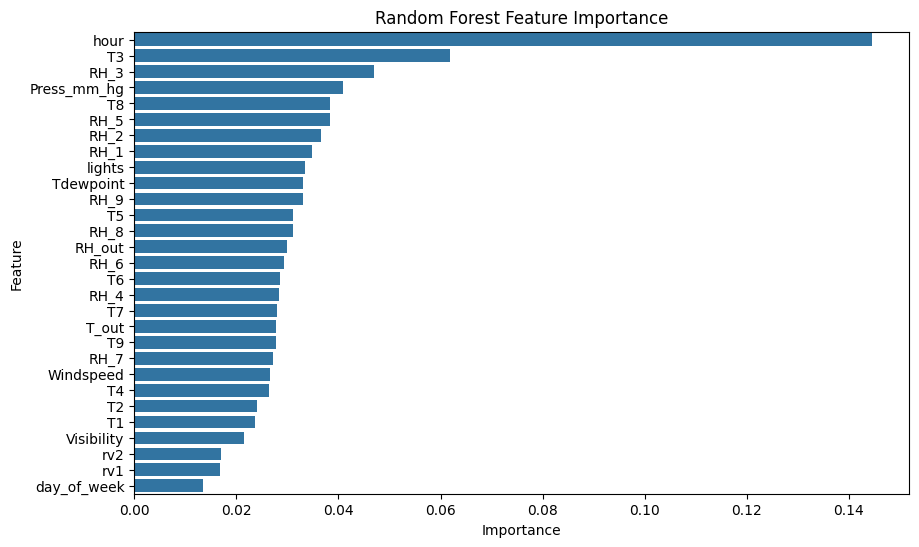

In [20]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor(random_state=1)  # You can add hyperparameters here if needed
rf.fit(X_train, y_train)

# Predictions and Evaluation for Training Set
y_pred_rf_train = rf.predict(X_train)
rmse_rf_train = np.sqrt(mean_squared_error(y_train, y_pred_rf_train))
mae_rf_train = mean_absolute_error(y_train, y_pred_rf_train)
r2_rf_train = r2_score(y_train, y_pred_rf_train)
mape_rf_train = np.mean(np.abs((y_train - y_pred_rf_train) / y_train)) * 100

print("\nRandom Forest Model Evaluation (Training Set):")
print(f"RMSE: {rmse_rf_train:.2f}")
print(f"MAE: {mae_rf_train:.2f}")
print(f"R-squared: {r2_rf_train:.2f}")
print(f"MAPE: {mape_rf_train:.2f}")


# Predictions and Evaluation for Testing Set
y_pred_rf_test = rf.predict(X_test)
rmse_rf_test = np.sqrt(mean_squared_error(y_test, y_pred_rf_test))
mae_rf_test = mean_absolute_error(y_test, y_pred_rf_test)
r2_rf_test = r2_score(y_test, y_pred_rf_test)
mape_rf_test = np.mean(np.abs((y_test - y_pred_rf_test) / y_test)) * 100

print("\nRandom Forest Model Evaluation (Testing Set):")
print(f"RMSE: {rmse_rf_test:.2f}")
print(f"MAE: {mae_rf_test:.2f}")
print(f"R-squared: {r2_rf_test:.2f}")
print(f"MAPE: {mape_rf_test:.2f}")


# Feature Importance
feature_importances = rf.feature_importances_
feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})
feature_importance_df = feature_importance_df.sort_values('Importance', ascending=False)
print("\nFeature Importance:")
print(feature_importance_df)

# visualize feature importance with a bar plot:
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
plt.title('Random Forest Feature Importance')
plt.show()


Gradient Boosting

In [22]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# 1. Create and train the model:
gb = GradientBoostingRegressor(n_estimators=1000, learning_rate=0.1, max_depth=3, random_state=1) # Example hyperparameters
gb.fit(X_train, y_train)

# 2. Make predictions:
y_pred_gb_train = gb.predict(X_train)  # Predictions for the training set
y_pred_gb_test = gb.predict(X_test)    # Predictions for the test set

# 3. Define the MAPE function:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 4. Evaluate the model (training set):
rmse_gb_train = np.sqrt(mean_squared_error(y_train, y_pred_gb_train))
mae_gb_train = mean_absolute_error(y_train, y_pred_gb_train)
r2_gb_train = r2_score(y_train, y_pred_gb_train)
mape_gb_train = mape(y_train, y_pred_gb_train)

# 5. Evaluate the model (testing set):
rmse_gb_test = np.sqrt(mean_squared_error(y_test, y_pred_gb_test))
mae_gb_test = mean_absolute_error(y_test, y_pred_gb_test)
r2_gb_test = r2_score(y_test, y_pred_gb_test)
mape_gb_test = mape(y_test, y_pred_gb_test)

# 6. Print the results:
print("Gradient Boosting Model Evaluation (Training Set):")
print(f"RMSE: {rmse_gb_train:.2f}")
print(f"MAE: {mae_gb_train:.2f}")
print(f"R-squared: {r2_gb_train:.2f}")
print(f"MAPE: {mape_gb_train:.2f}")

print("\nGradient Boosting Model Evaluation (Testing Set):")
print(f"RMSE: {rmse_gb_test:.2f}")
print(f"MAE: {mae_gb_test:.2f}")
print(f"R-squared: {r2_gb_test:.2f}")
print(f"MAPE: {mape_gb_test:.2f}")

Gradient Boosting Model Evaluation (Training Set):
RMSE: 52.88
MAE: 29.48
R-squared: 0.73
MAPE: 33.89

Gradient Boosting Model Evaluation (Testing Set):
RMSE: 78.55
MAE: 40.58
R-squared: 0.44
MAPE: 41.43


XG Boost

In [23]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# 1. Create and train the model:
xgb = XGBRegressor(n_estimators=1000, learning_rate=0.1, max_depth=3, random_state=1)
xgb.fit(X_train, y_train)

# 2. Make predictions:
y_pred_xgb_train = xgb.predict(X_train)  # Predictions for the training set
y_pred_xgb_test = xgb.predict(X_test)    # Predictions for the test set

# 3. Define the MAPE function:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# 4. Evaluate the model (training set):
rmse_xgb_train = np.sqrt(mean_squared_error(y_train, y_pred_xgb_train))
mae_xgb_train = mean_absolute_error(y_train, y_pred_xgb_train)
r2_xgb_train = r2_score(y_train, y_pred_xgb_train)
mape_xgb_train = mape(y_train, y_pred_xgb_train)

# 5. Evaluate the model (testing set):
rmse_xgb_test = np.sqrt(mean_squared_error(y_test, y_pred_xgb_test))
mae_xgb_test = mean_absolute_error(y_test, y_pred_xgb_test)
r2_xgb_test = r2_score(y_test, y_pred_xgb_test)
mape_xgb_test = mape(y_test, y_pred_xgb_test)

# 6. Print the results:
print("XGBoost Model Evaluation (Training Set):")
print(f"RMSE: {rmse_xgb_train:.2f}")
print(f"MAE: {mae_xgb_train:.2f}")
print(f"R-squared: {r2_xgb_train:.2f}")
print(f"MAPE: {mape_xgb_train:.2f}")

print("\nXGBoost Model Evaluation (Testing Set):")
print(f"RMSE: {rmse_xgb_test:.2f}")
print(f"MAE: {mae_xgb_test:.2f}")
print(f"R-squared: {r2_xgb_test:.2f}")
print(f"MAPE: {mape_xgb_test:.2f}")

XGBoost Model Evaluation (Training Set):
RMSE: 56.59
MAE: 30.87
R-squared: 0.69
MAPE: 34.74

XGBoost Model Evaluation (Testing Set):
RMSE: 77.28
MAE: 40.10
R-squared: 0.45
MAPE: 40.68


In [ ]:
# SVM
svm = SVR(C=10, kernel='rbf', gamma=0.1)
svm.fit(X_train, y_train)

SVM

In [24]:
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# Function to calculate MAPE
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Create and train the SVM model
svm = SVR(kernel='rbf')
svm.fit(X_train, y_train)

# Predictions and Evaluation for Training Set
y_pred_svm_train = svm.predict(X_train)
rmse_svm_train = np.sqrt(mean_squared_error(y_train, y_pred_svm_train))
mae_svm_train = mean_absolute_error(y_train, y_pred_svm_train)
r2_svm_train = r2_score(y_train, y_pred_svm_train)
mape_svm_train = mape(y_train, y_pred_svm_train)  # Calculate MAPE for training set

print("\nSVM Model Evaluation (Training Set):")
print(f"RMSE: {rmse_svm_train:.2f}")
print(f"MAE: {mae_svm_train:.2f}")
print(f"R-squared: {r2_svm_train:.2f}")
print(f"MAPE: {mape_svm_train:.2f}")  # Print MAPE for training set


# Predictions and Evaluation for Testing Set
y_pred_svm_test = svm.predict(X_test)
rmse_svm_test = np.sqrt(mean_squared_error(y_test, y_pred_svm_test))
mae_svm_test = mean_absolute_error(y_test, y_pred_svm_test)
r2_svm_test = r2_score(y_test, y_pred_svm_test)
mape_svm_test = mape(y_test, y_pred_svm_test)   # Calculate MAPE for testing set

print("\nSVM Model Evaluation (Testing Set):")
print(f"RMSE: {rmse_svm_test:.2f}")
print(f"MAE: {mae_svm_test:.2f}")
print(f"R-squared: {r2_svm_test:.2f}")
print(f"MAPE: {mape_svm_test:.2f}")   # Print MAPE for testing set




SVM Model Evaluation (Training Set):
RMSE: 101.39
MAE: 44.03
R-squared: 0.01
MAPE: 35.46

SVM Model Evaluation (Testing Set):
RMSE: 104.32
MAE: 46.30
R-squared: 0.00
MAPE: 35.57


Model Evaluation

In [26]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Define MAPE function
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Model Evaluation
models = {
    'Linear Regression': lr,
    'Random Forest': rf,
    'Gradient Boosting': gb,
    'SVM': svm,
    'XGBoost': xgb
}

results = []
for name, model in models.items():
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    results.append({
        'Model': name,
        'Train RMSE': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'Test RMSE': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred),
        'Train R2': r2_score(y_train, y_train_pred),
        'Test R2': r2_score(y_test, y_test_pred),
        'Train MAPE': mape(y_train, y_train_pred),  # Added MAPE for training
        'Test MAPE': mape(y_test, y_test_pred)     # Added MAPE for testing
    })

results_df = pd.DataFrame(results)
print(results_df)

               Model  Train RMSE   Test RMSE  Train MAE   Test MAE  Train R2  \
0  Linear Regression   92.963469   95.210856  52.079889  53.521134  0.166531   
1      Random Forest   26.610367   71.706622  12.471549  34.053445  0.931709   
2  Gradient Boosting   52.881306   78.548155  29.480303  40.575471  0.730307   
3                SVM  101.392703  104.318845  44.027051  46.295132  0.008533   
4            XGBoost   56.590387   77.281051  30.871517  40.096302  0.691148   

    Test R2  Train MAPE  Test MAPE  
0  0.170674   60.108857  59.744043  
1  0.529596   12.394420  32.572044  
2  0.435551   33.887149  41.429658  
3  0.004416   35.455603  35.571808  
4  0.453615   34.735246  40.680796  


In [25]:
# Model Evaluation
models = {
    'Linear Regression': lr,
    'Random Forest': rf,
    'Gradient Boosting': gb,
    'SVM': svm,
    'XGBoost': xgb
}

results = []
for name, model in models.items():
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    results.append({
        'Model': name,
        'Train RMSE': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'Test RMSE': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred),
        'Train R2': r2_score(y_train, y_train_pred),
        'Test R2': r2_score(y_test, y_test_pred)
    })

results_df = pd.DataFrame(results)
print(results_df)


               Model  Train RMSE   Test RMSE  Train MAE   Test MAE  Train R2  \
0  Linear Regression   92.963469   95.210856  52.079889  53.521134  0.166531   
1      Random Forest   26.610367   71.706622  12.471549  34.053445  0.931709   
2  Gradient Boosting   52.881306   78.548155  29.480303  40.575471  0.730307   
3                SVM  101.392703  104.318845  44.027051  46.295132  0.008533   
4            XGBoost   56.590387   77.281051  30.871517  40.096302  0.691148   

    Test R2  
0  0.170674  
1  0.529596  
2  0.435551  
3  0.004416  
4  0.453615  


Model Comparison

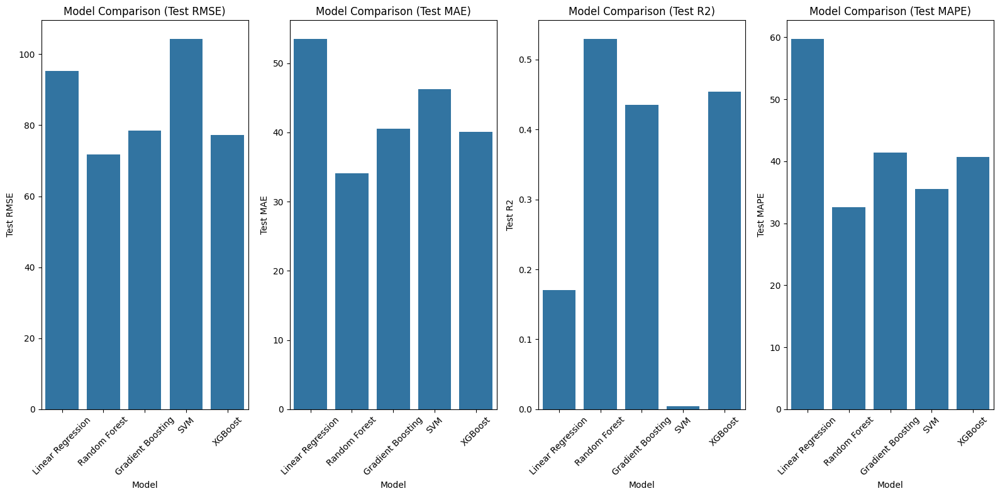

In [29]:
# Visualization of Model Performance Metrics
metrics = ['Test RMSE', 'Test MAE', 'Test R2', 'Test MAPE']  # Include MAPE

plt.figure(figsize=(16, 8))  # Adjust figure size if needed
for i, metric in enumerate(metrics):
    plt.subplot(1, len(metrics), i + 1)
    sns.barplot(x='Model', y=metric, data=results_df)
    plt.title(f'Model Comparison ({metric})')
    plt.xticks(rotation=45)
    plt.tight_layout()

plt.show()

Subset Analysis (example with no lights)

In [31]:
X_train_no_lights = X_train.drop('lights', axis=1)
X_test_no_lights = X_test.drop('lights', axis=1)

gb_no_lights = GradientBoostingRegressor(n_estimators=10900, learning_rate=0.1,
                                        max_depth=5, min_samples_leaf=10, random_state=1)
gb_no_lights.fit(X_train_no_lights, y_train)

GradientBoostingRegressor(max_depth=5, min_samples_leaf=10, n_estimators=10900,
                          random_state=1)

In [32]:
# Evaluate
y_test_pred_no_lights = gb_no_lights.predict(X_test_no_lights)
print("No lights model test RMSE:", np.sqrt(mean_squared_error(y_test, y_test_pred_no_lights)))

No lights model test RMSE: 68.54975823005402


# Connect SowFlakes with Colab

Install Snowflake Connector


In [33]:
!pip install snowflake-connector-python pandas matplotlib plotly

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 28.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.0/105.0 kB 6.5 MB/s eta 0:00:00


2. Import Libraries and Connect

In [35]:
import snowflake.connector
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

# Establish connection
conn = snowflake.connector.connect(
    user='JoshuaGashan',
    password='hZyiVd9vQYKJqQf',
    account='uo43113.ap-south-1.aws',
    warehouse='COMPUTE_WH',
    database='APPLIANCES_ENERGY_DATABASE',
    schema='APPLIANCE_ENERGY_SCHEMA'
)

Check if the connection to Snowflake is successful

In [36]:
# Check if the connection to Snowflake is successful
try:
  cursor = conn.cursor()
  cursor.execute("SELECT current_version()")
  one_row = cursor.fetchone()
  print(f"Snowflake Version: {one_row[0]}")
  print("Connection to Snowflake is successful!")

  # Proceed with your Snowflake-related code after a successful connection
  # For example, you can query data or perform operations on the Snowflake database.

except Exception as e:
  print(f"Error connecting to Snowflake: {e}")


Snowflake Version: 9.7.2
Connection to Snowflake is successful!


In [40]:
# Simple test query to verify data access
test_query = """
SELECT
    DATE AS reading_date,
    APPLIANCES,
    LIGHTS,
    T1 AS kitchen_temp
FROM APPLIANCES_ENERGY_TABLE
ORDER BY DATE DESC
LIMIT 10
"""

df_test = pd.read_sql(test_query, conn)
df_test.head()

,READING_DATE,APPLIANCES,LIGHTS,KITCHEN_TEMP
0,2016-05-27 18:00:00,430,10,25.500000
1,2016-05-27 17:50:00,420,10,25.500000
2,2016-05-27 17:40:00,270,10,25.500000
3,2016-05-27 17:30:00,90,0,25.500000
4,2016-05-27 17:20:00,100,0,25.566667


<Figure size 1000x600 with 0 Axes>

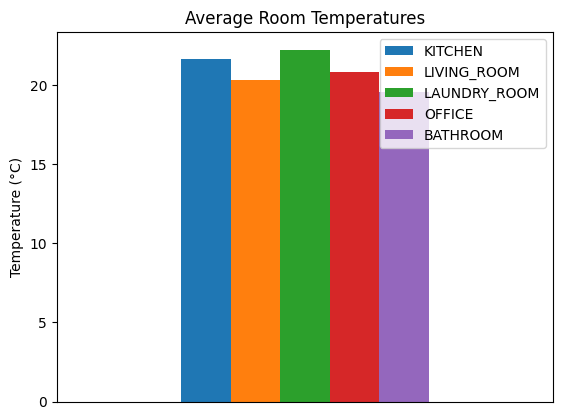

In [39]:
# Get room temperature data
temp_query = """
SELECT
    AVG(T1) AS kitchen,
    AVG(T2) AS living_room,
    AVG(T3) AS laundry_room,
    AVG(T4) AS office,
    AVG(T5) AS bathroom
FROM APPLIANCES_ENERGY_TABLE
"""

df_temp = pd.read_sql(temp_query, conn)

# Create bar chart
plt.figure(figsize=(10,6))
df_temp.plot(kind='bar', title='Average Room Temperatures')
plt.ylabel('Temperature (°C)')
plt.xticks([])
plt.show()

In [ ]:
# First, let's standardize the column names
df_corr.columns = df_corr.columns.str.upper()  # Convert all column names to uppercase

# Verify the column names
print("Available columns:", df_corr.columns.tolist())

# Now create the visualization with correct column names
fig = px.scatter(df_corr,
                 x='OUTDOOR_TEMP',  # Using the uppercase column name
                 y='TOTAL_ENERGY',
                 trendline='ols',
                 title='Energy vs Outdoor Temperature',
                 labels={
                     'OUTDOOR_TEMP': 'Outdoor Temperature (°C)',
                     'TOTAL_ENERGY': 'Total Energy Consumption (Wh)'
                 })

fig.show()

Available columns: ['OUTDOOR_TEMP', 'TOTAL_ENERGY', 'WINDSPEED']


In [ ]:
# After running your query and getting a DataFrame
df = pd.read_sql("SELECT * FROM APPLIANCES_ENERGY_TABLE LIMIT 100", conn)

# Display first 5 rows
df.head()

<ipython-input-22-7a9ff4ad93ab>:2: UserWarning:

pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.



,DATE,APPLIANCES,LIGHTS,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_OUT,PRESS_MM_HG,RH_OUT,WINDSPEED,VISIBILITY,TDEWPOINT,RV1,RV2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.5999999999999996e+00,733.5,92.000000000000000,7.00000000000000000,63.0000000000000000,5.2999999999999998e+00,13.2754331571049988270,13.2754331571049988270
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.4833333333333298e+00,733.6,92.000000000000000,6.66666666666666963,59.1666666666666998,5.2000000000000002e+00,18.6061949818395078182,18.6061949818395078182
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.3666666666666698e+00,733.7,92.000000000000000,6.33333333333333037,55.3333333333333002,5.0999999999999996e+00,28.6426681675948202610,28.6426681675948202610
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.2500000000000000e+00,733.8,92.000000000000000,6.00000000000000000,51.5000000000000000,5.0000000000000000e+00,45.4103894997388124466,45.4103894997388124466
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.1333333333333302e+00,733.9,92.000000000000000,5.66666666666666963,47.6666666666666998,4.9000000000000004e+00,10.0840965518727898598,10.0840965518727898598


In [ ]:
from IPython.display import display
display(df.head())

,DATE,APPLIANCES,LIGHTS,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_OUT,PRESS_MM_HG,RH_OUT,WINDSPEED,VISIBILITY,TDEWPOINT,RV1,RV2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.5999999999999996e+00,733.5,92.000000000000000,7.00000000000000000,63.0000000000000000,5.2999999999999998e+00,13.2754331571049988270,13.2754331571049988270
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.4833333333333298e+00,733.6,92.000000000000000,6.66666666666666963,59.1666666666666998,5.2000000000000002e+00,18.6061949818395078182,18.6061949818395078182
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.3666666666666698e+00,733.7,92.000000000000000,6.33333333333333037,55.3333333333333002,5.0999999999999996e+00,28.6426681675948202610,28.6426681675948202610
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.2500000000000000e+00,733.8,92.000000000000000,6.00000000000000000,51.5000000000000000,5.0000000000000000e+00,45.4103894997388124466,45.4103894997388124466
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.1333333333333302e+00,733.9,92.000000000000000,5.66666666666666963,47.6666666666666998,4.9000000000000004e+00,10.0840965518727898598,10.0840965518727898598


In [ ]:

print("DataFrame columns:", hourly_df.columns.tolist())

# Corrected plot using actual column names
fig = px.line(hourly_df,
              x='HOUR',  # Using exact column name from DataFrame
              y=['APPLIANCES', 'LIGHTS'],
              title='Hourly Energy Consumption',
              labels={'value': 'Energy (Wh)', 'HOUR': 'Time'})
fig.show()

DataFrame columns: ['HOUR', 'APPLIANCES', 'LIGHTS']


<ipython-input-31-4245c1e9102d>:11: UserWarning:

pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.



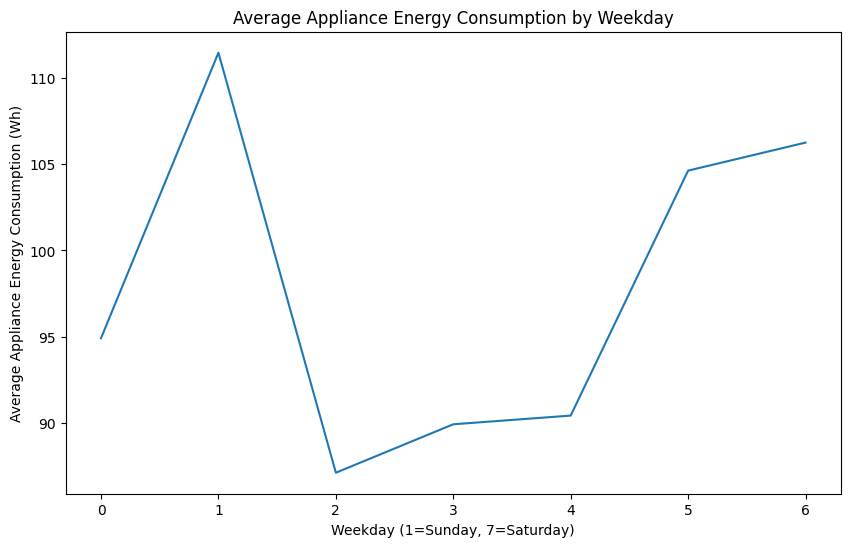

<ipython-input-31-4245c1e9102d>:29: UserWarning:

pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.



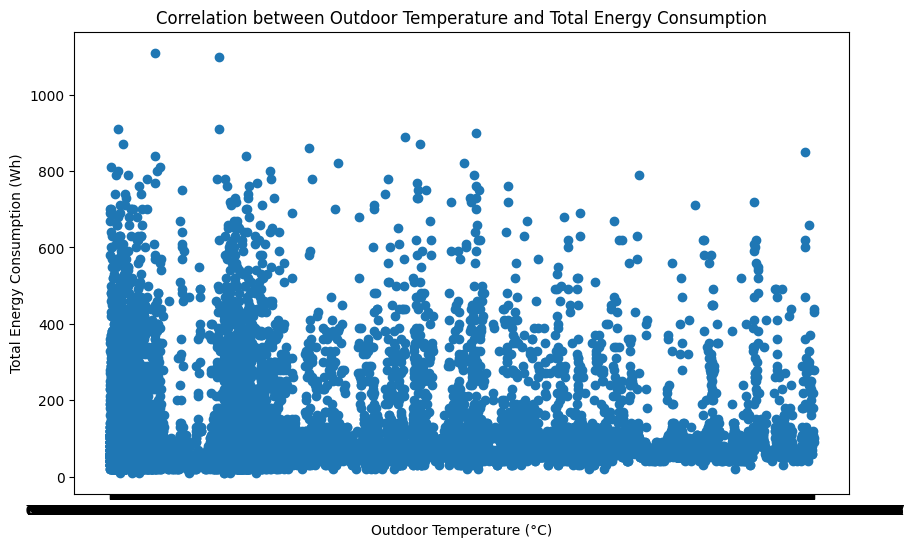

In [ ]:
# Example visualization: Average appliance energy consumption per weekday
weekday_query = """
SELECT
    DAYOFWEEK(DATE) AS weekday,
    AVG(APPLIANCES) AS avg_appliance_energy
FROM APPLIANCES_ENERGY_TABLE
GROUP BY weekday
ORDER BY weekday
"""

df_weekday = pd.read_sql(weekday_query, conn)

# Plotting the average appliance energy consumption per weekday
plt.figure(figsize=(10, 6))
plt.plot(df_weekday['WEEKDAY'], df_weekday['AVG_APPLIANCE_ENERGY'])
plt.xlabel('Weekday (1=Sunday, 7=Saturday)')
plt.ylabel('Average Appliance Energy Consumption (Wh)')
plt.title('Average Appliance Energy Consumption by Weekday')
plt.show()

# Another example visualization: Correlation between outdoor temperature and total energy consumption
correlation_query = """
SELECT
    T6 AS outdoor_temp,
    APPLIANCES + LIGHTS AS total_energy
FROM APPLIANCES_ENERGY_TABLE
"""

df_corr = pd.read_sql(correlation_query, conn)

# Plotting the correlation between outdoor temperature and total energy consumption
plt.figure(figsize=(10, 6))
plt.scatter(df_corr['OUTDOOR_TEMP'], df_corr['TOTAL_ENERGY'])
plt.xlabel('Outdoor Temperature (°C)')
plt.ylabel('Total Energy Consumption (Wh)')
plt.title('Correlation between Outdoor Temperature and Total Energy Consumption')
plt.show()